In [ ]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        os.path.join(dirname, filename)

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

In [ ]:
CAPTION_PATH = '/kaggle/input/flickr8k/captions.txt'
IMAGE_PATH = '/kaggle/input/flickr8k/images/'

In [ ]:
caption_df = pd.read_csv(CAPTION_PATH, sep='|')

In [ ]:
caption_df.head()

In [ ]:
captions = caption_df['caption_text']

In [ ]:
captions

In [ ]:
captions = captions.tolist() # change from df object to list

In [ ]:
captions[:3]

In [ ]:
# create a dictionary for word
word2id = {}
word2id['<SOS>'] = 0
word2id['<EOS>'] = 1
word2id['<PAD>'] = 2
word2id['<UNK>'] = 3
i = 4
for cap in captions:
    for word in cap.split():
        word = word.lower()
        if word not in word2id:
            word2id[word] = i 
            i+= 1
            
            

In [ ]:
print(len(word2id))
vocab_size = len(word2id) # 8922 different word

In [ ]:
# creating a dictionary for reverse from the id to word, using for generating part
id2word = {v : k for k, v in word2id.items()}

In [ ]:
# process for image part
from PIL import Image
import torch
from torchvision import transforms
import os


In [ ]:
transform = transforms.Compose([
    transforms.Resize((299, 299)), # for input of pretrained inception-v3 is
    transforms.RandomCrop(299), # For augmentation
    transforms.ToTensor(), # Convert image to [C, H, W] tensor
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

In [ ]:
print(IMAGE_PATH)

In [ ]:
train_data = []
epoch = len(captions)
cnt = 0
for i in range(epoch):
    if i % 5 == 0:
        img_path = IMAGE_PATH + caption_df['image_name'][i]
        # print(img_path)
        img = Image.open(img_path)
        img_tensor = transform(img)
    train_data.append([img_tensor ,captions[i]])

print("DONE!!")
print(len(train_data))

In [ ]:
print(train_data[0][0].shape) # check type of image tensor [C, H, W]
# type = 3

In [ ]:
from torch.utils.data import Dataset, DataLoader

In [ ]:
# Create custom dataset
class ImageCaptioningDataset(Dataset):
    def __init__(self, img_tensor, captions):
        self.img_tensor = img_tensor
        self.captions = captions
    def __len__(self):
        return len(self.captions)
    def __getitem__(self, idx):
        return torch.tensor(self.img_tensor[idx]), torch.tensor(self.captions[idx])


In [ ]:
train_idx = int(0.65 * len(train_data))
val_idx = int(0.8 * len(train_data))

In [ ]:
# encode the caption
encode_caption = []
image_list = []
def encode(sentence, max_length = 50):
    output = []
    output.append(word2id["<SOS>"])
    for word in sentence.split():
        output.append(word2id[word.lower()])
    output.append(word2id["<EOS>"])
    for i in range(len(output), max_length):
        output.append(word2id["<PAD>"])
    return output

for img_tensor, caption in train_data:
    image_list.append(img_tensor)
    encode_caption.append(encode(caption))

In [ ]:
image_list[:3]

In [ ]:
train_dataset = ImageCaptioningDataset(image_list[:train_idx], encode_caption[:train_idx])
valid_dataset = ImageCaptioningDataset(image_list[train_idx : val_idx], encode_caption[train_idx: val_idx])
test_dataset = ImageCaptioningDataset(image_list[val_idx:], encode_caption[val_idx:])

In [ ]:
train_dataset.__getitem__(idx=0)

In [ ]:
train_dataloader = DataLoader(train_dataset, batch_size = 128, shuffle = True)
valid_dataloader = DataLoader(valid_dataset, batch_size = 128, shuffle = True)
test_dataloader = DataLoader(test_dataset, batch_size = 128, shuffle = True)

In [ ]:
train_dataloader

In [ ]:
from torchvision import models
import torch.nn as nn

In [ ]:
from torchvision.models import inception_v3, Inception_V3_Weights

In [ ]:
!wget http://nlp.stanford.edu/data/glove.6B.zip
!unzip glove.6B.zip

In [ ]:
# Encoder based on pretrained InceptionV3
class CNNBasedEncoder(nn.Module):
    def __init__(self, embed_dim=300, dropout_p=0.5):
        super().__init__()
        inception = models.inception_v3(weights=Inception_V3_Weights.IMAGENET1K_V1)
        for param in inception.parameters():
            param.requires_grad = False # use pretrained layer directly without training
        inception.fc = nn.Identity()
        self.inception = inception
        self.dropout = nn.Dropout(dropout_p)
        # map the features to the embed_dim
        self.image_proj = nn.Sequential(
            nn.Linear(2048, 1024),
            nn.ReLU(),
            nn.Linear(1024, 512),
            nn.ReLU(),
            nn.Linear(512, embed_dim)
        )        
        self.bn = nn.BatchNorm1d(embed_dim, momentum=0.01)

    def forward(self, images):
        features = self.inception(images) # shape : [batch, 2048]
        if isinstance(features, tuple):  # If output is a tuple, take the first item
            features = features[0]
        # print(features.shape)
        features = self.dropout(features) # shape = [batch, 2048]
        features = self.image_proj(features) # shape [batch, embed_dim] 
        features = self.bn(features) 
        return features # shape = [batch, 256]

In [ ]:
import pandas as pd

In [ ]:
import numpy as np
def load_glove_embeddings(glove_path, word2id, embed_dim=300):
    vocab_size = len(word2id)
    embedding_matrix = np.random.uniform(-0.1, 0.1, (vocab_size, embed_dim))  # Random init for OOV words
    with open(glove_path, 'r', encoding = 'utf-8') as f:
        for line in f:
            values = line.split()
            word = values[0]
            embedded_vector = np.array(values[1:], dtype=np.float32) # get the vector dim of word
            if word in word2id:
                embedding_matrix[word2id[word]] = embedded_vector
    return embedding_matrix

            

In [ ]:
# get the embedding matrix [vocab_size, embedded_dim = 300]
glove_path = '/kaggle/working/glove.6B.300d.txt'
embedding_matrix = load_glove_embeddings(glove_path, word2id)
embedding_matrix = torch.tensor(embedding_matrix, dtype=torch.float)

In [ ]:
embedding_matrix.shape

In [ ]:
class DecoderRNN(nn.Module):
    def __init__(self, vocab_size, embed_dim=300, hidden_dim = 512, dropout_p = 0.3):
        super().__init__()
        self.embedding = nn.Embedding(vocab_size, embed_dim) # [vocab_size, embed_dim]
        if embedding_matrix is not None:
            self.embedding.weight.data.copy_(embedding_matrix)  # Load GloVe weights
        for param in self.embedding.parameters():
            param.requires_grad = False
        self.dropout = nn.Dropout(dropout_p)
        self.lstm = nn.LSTM(embed_dim, hidden_dim, batch_first=True)
        self.linear = nn.Linear(hidden_dim, vocab_size) # # [batch, seq_len, word_dim], output layer
        # self.fc1 = nn.Linear()
    def forward(self, captions, features):
        embedded = self.embedding(captions) # [batch, seq_len, 200]
        embedded = self.dropout(embedded)
        features = features.unsqueeze(1) # [batch, 1, 256]
        combined = torch.cat((features, embedded), dim=1)  # [batch, seq_len + 1, embed_dim_word]
        outputs, _ = self.lstm(combined) # [batch, seq_len + 1, hidden_dim]
        outputs = self.linear(outputs) # [batch, seq_len + 1, vocab_dim]
        # caption_vec = h_n.squeeze(0) # [batch, hidden_dim] [batch, 256]
        return outputs
        


In [ ]:
class Encoder_Decoder(nn.Module):
    def __init__(self, vocab_size, embed_dim=300, hidden_dim=512, dropout_p=0.3):
        super().__init__()
        self.encoder = CNNBasedEncoder(embed_dim = embed_dim, dropout_p = dropout_p)
        self.decoder = DecoderRNN(vocab_size, embed_dim = embed_dim, hidden_dim = hidden_dim)
        # self.fc1 = nn.Linear(hidden_dim, hidden_dim) # dense layer (256 units)
        # self.fc2 = nn.Linear(hidden_dim, vocab_size)
    def forward(self, captions, images):
        img_vec = self.encoder(images) # [batch, 256]
        cap_vec = self.decoder(captions, img_vec) # [batch, seq_len + 1, ]
        return cap_vec
    def sample(self, images, max_len=50):
        features = self.encoder(images)
        batch_size = features.size(0)
        sampled_ids = []
        inputs = features.unsqueeze(1)
        state = None
        for t in range(max_len):
            # Make sure to pass image feature along with the current input sequence
            hidden, state = self.decoder.lstm(inputs, state)
            logits = self.decoder.linear(hidden.squeeze(1)) # (batch, vocab_size)
            predicted = logits.argmax(dim=1)
            sampled_ids.append(predicted)
            inputs = self.decoder.embedding(predicted)
            inputs = inputs.unsqueeze(1)
        sampled_ids = torch.stack(sampled_ids, dim = 1)
        return sampled_ids

In [ ]:
# if __name__ == '__main__':
#     batch_size = 32
#     seq_len = 34
#     word_size = 1652
#     # Dummy caption input: [batch, 34]
#     dummy_captions = torch.randint(0, vocab_size, (batch_size, seq_len))
#     # Dummy image input: [batch, 3, 299, 299] (InceptionV3 requires 299x299 images)
#     dummy_images = torch.randn(batch_size, 3, 299, 299)

#     model = Encoder_Decoder(vocab_size=word_size)
#     outputs = model(dummy_captions, dummy_images)
#     print("Output shape:", outputs.shape)  # Expected: [32, 1652]

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"
print(f"Using device: {device}")
model = Encoder_Decoder(vocab_size = vocab_size)
model = model.to(device)

In [ ]:
def evaluate_loss(model, val_dataloader, criterion, device):
    model.eval()
    total_loss = 0.0
    with torch.no_grad():
        for images, captions in val_dataloader:
            images, captions = images.to(device), captions.to(device)

            input_captions = captions[:, :-1]  # Input sequence
            target_captions = captions[:, 1:]  # Shifted target sequence

            outputs = model(input_captions, images)
            outputs = outputs[:, 1:, :] # remove the features used before as seq

            # Flatten for loss calculation
            outputs = outputs.reshape(-1, outputs.shape[-1])
            target_captions = target_captions.reshape(-1)

            loss = criterion(outputs, target_captions)
            total_loss += loss.item()

    avg_loss = total_loss / len(val_dataloader)
    model.train()
    return avg_loss


In [ ]:
from torch import optim

# Training function
def train(model, train_dataloader, epochs, lr, device):
    # Ensure PAD token exists in word2id
    pad_index = word2id['<PAD>']  # Default to 0 if <PAD> is missing

    # Define loss function & optimizer
    criterion = nn.CrossEntropyLoss(ignore_index=pad_index)
    params = list(model.decoder.parameters()) + list(model.encoder.image_proj.parameters()) + list(model.encoder.bn.parameters())
    num_trainable_params = sum(p.numel() for p in params if p.requires_grad)
    print(f"Total number of trainable parameters: {num_trainable_params}")

    optimizer = optim.Adam(params, lr=lr)

    model.to(device)
    model.train()

    for epoch in range(epochs):
        total_loss = 0.0
        for batch_idx, (images, captions) in enumerate(train_dataloader):
            images, captions = images.to(device), captions.to(device)
        
            optimizer.zero_grad()
        
            # Ignore <START> token for input, shift right for target
            input_captions = captions[:, :-1]  # Exclude last word
            target_captions = captions[:, 1:]  # Exclude first word (shifted) # [batch, seq_len - 1, vocab_size]
            # print("Target shape: ", target_captions.shape)
            outputs = model(input_captions, images)  # Output shape: [batch, seq_len, vocab_size]
            outputs = outputs[:, 1:, :] # remove the features used before as seq
            # print("Output shape: ", outputs.shape)

            # Reshape for loss calculation
            outputs = outputs.reshape(-1, outputs.shape[-1])  # Flatten batch & sequence
            # print("Output shape: ", outputs.shape)
            target_captions = target_captions.reshape(-1)  # Flatten targets
        
            loss = criterion(outputs, target_captions)  # Compute loss over full sequence
            loss.backward()
            optimizer.step()
        
            total_loss += loss.item()

            if (batch_idx + 1) % 10 == 0:
                print(f"Epoch [{epoch+1}/{epochs}], Step [{batch_idx+1}/{len(train_dataloader)}], Loss: {loss.item():.4f}")

        # Validation loss
        criterion = nn.CrossEntropyLoss(ignore_index=word2id["<PAD>"])
        val_loss = evaluate_loss(model, valid_dataloader, criterion, device)

        print(f"Epoch [{epoch+1}/{epochs}] Validation Loss: {val_loss:.4f}")

        # Print average training loss
        avg_loss = total_loss / len(train_dataloader)
        print(f"Epoch [{epoch+1}/{epochs}] Average Training Loss: {avg_loss:.4f}")



In [ ]:
train(model, train_dataloader = train_dataloader,  epochs = 10, lr = 1e-3, device=device)

In [ ]:
import torch
import matplotlib.pyplot as plt
import torchvision.transforms as transforms

In [ ]:
import torch
import matplotlib.pyplot as plt

model.eval()
for i in range(0, 100, 5):
    img = image_list[i]
    img = img.to(device)
    img = img.unsqueeze(0)
    print(img.shape)
    encode_output = model.sample(img)
    # Ensure mean and std are on the same device
    img = img.squeeze(0)
    device = img.device  
    mean = torch.tensor([0.485, 0.456, 0.406], device=device).view(3, 1, 1)
    std = torch.tensor([0.229, 0.224, 0.225], device=device).view(3, 1, 1)
    # Denormalize the image (if normalized)
    img = img * std + mean  # Undo normalization
    
    # Move to CPU before converting to NumPy
    img_numpy = img.cpu().permute(1, 2, 0).clamp(0, 1).numpy()
    # Display the image
    plt.imshow(img_numpy)
    plt.axis('off')  # Hide axis
    plt.show()
    encode_output = encode_output.squeeze(0).tolist()
    true_output = []
    for char in encode_output:
        if char == 0: 
            continue
        elif char == 1:
            break
        true_character = id2word[char]
        true_output.append(true_character)
    generated_captions = ' '.join(true_output)
    print(generated_captions)

In [ ]:
criterion = nn.CrossEntropyLoss(ignore_index=word2id["<PAD>"])
val_loss = evaluate_loss(model, test_dataloader, criterion, device)

In [ ]:
val_loss

In [ ]:
train_idx

In [ ]:
val_idx

torch.Size([1, 3, 299, 299])


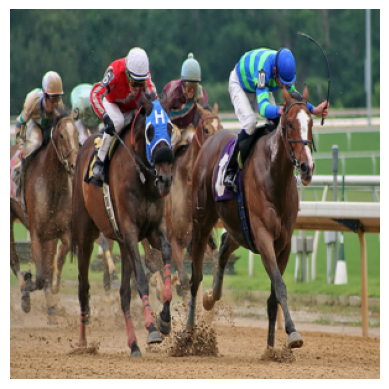

two people are riding horses on a track .
torch.Size([1, 3, 299, 299])


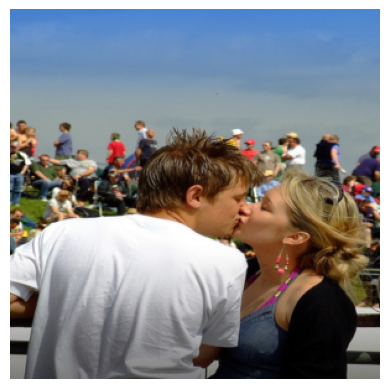

girl girl with a blue shirt and blue jeans is holding a drink .
torch.Size([1, 3, 299, 299])


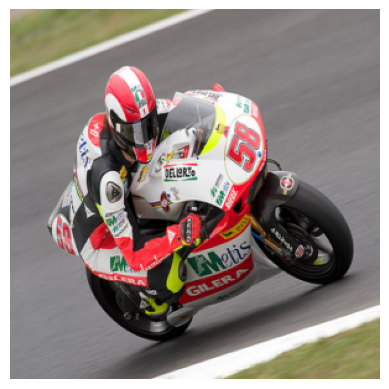

a man in a red jacket is riding a bike .
torch.Size([1, 3, 299, 299])


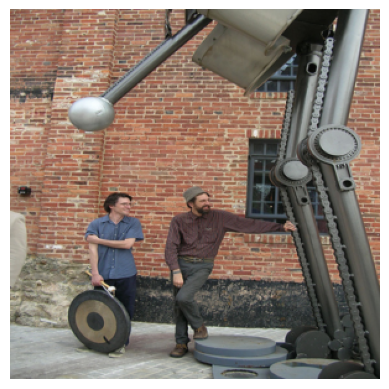

a man in a red shirt and a white shirt is riding a bicycle .
torch.Size([1, 3, 299, 299])


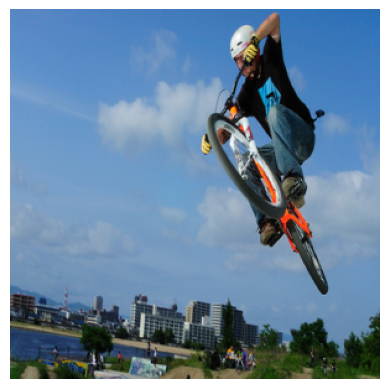

a man on a bike is jumping over a ramp .
torch.Size([1, 3, 299, 299])


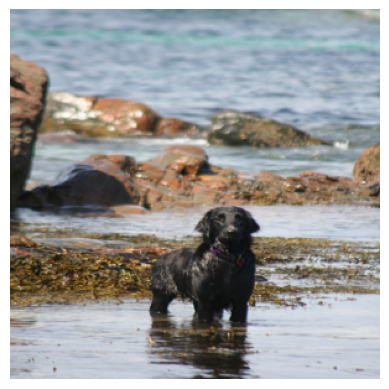

dog a black dog is running through the water .
torch.Size([1, 3, 299, 299])


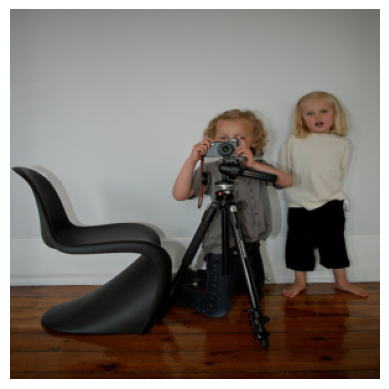

two people are sitting on a bench .
torch.Size([1, 3, 299, 299])


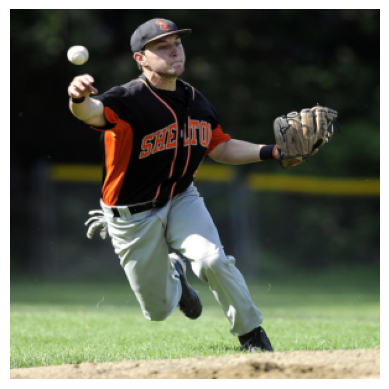

catcher a baseball player in a red uniform is holding a ball .
torch.Size([1, 3, 299, 299])


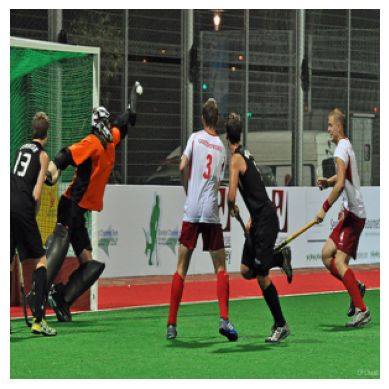

two men in red and white uniforms are playing soccer .
torch.Size([1, 3, 299, 299])


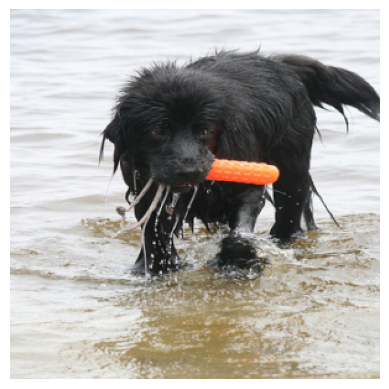

dog a black dog is running through the water .
torch.Size([1, 3, 299, 299])


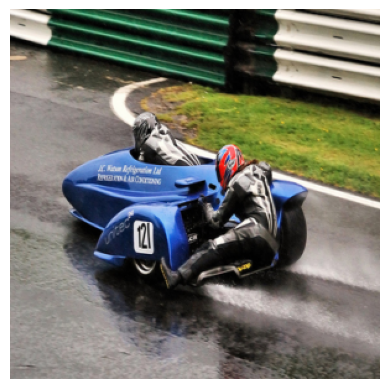

a man in a red shirt is riding a bike .
torch.Size([1, 3, 299, 299])


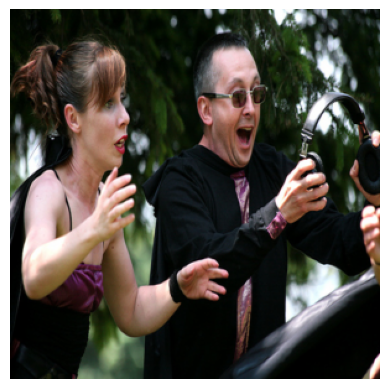

girl boy with a blue shirt and blue shirt is holding a camera .
torch.Size([1, 3, 299, 299])


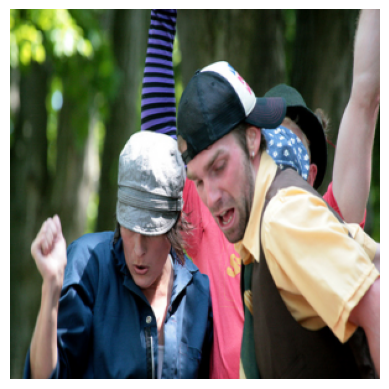

man man with a beard and a hat .
torch.Size([1, 3, 299, 299])


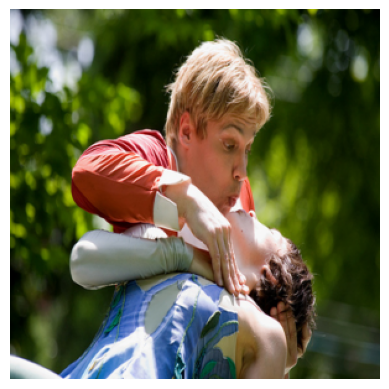

heavyset a little girl in a pink dress is holding a baby in a pink shirt .
torch.Size([1, 3, 299, 299])


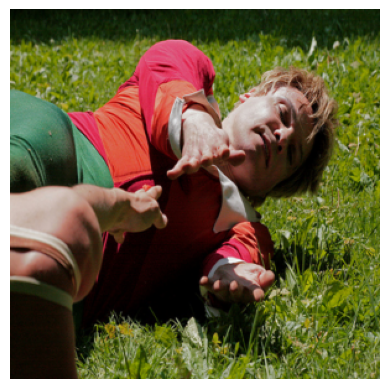

brown a brown dog is running through a field .
torch.Size([1, 3, 299, 299])


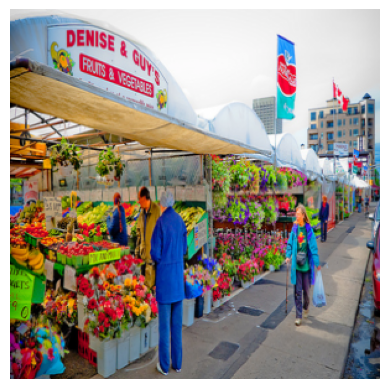

people a group of people are standing in a line of a building .
torch.Size([1, 3, 299, 299])


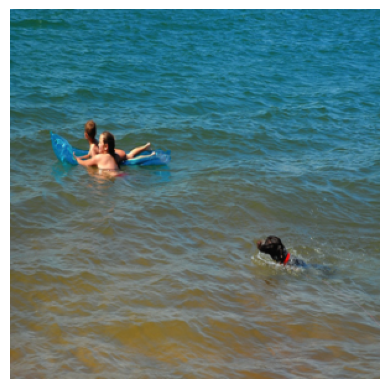

a man in a wetsuit is surfing .
torch.Size([1, 3, 299, 299])


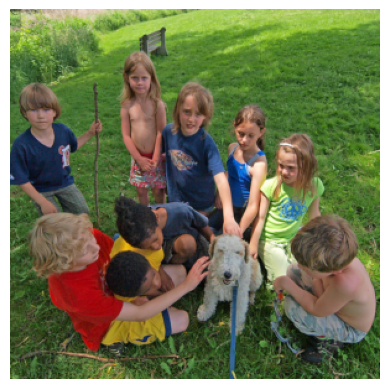

four people are standing in a field of a large field .
torch.Size([1, 3, 299, 299])


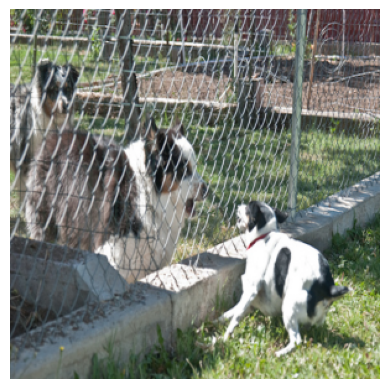

a black and white dog is running through the grass .
torch.Size([1, 3, 299, 299])


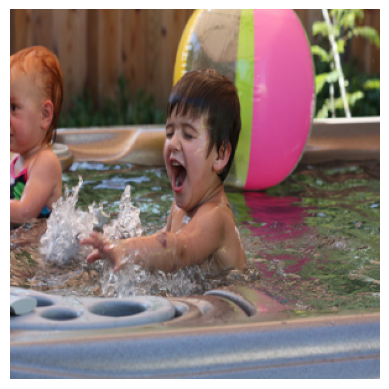

goggled a young boy wearing a blue shirt is jumping into a pool .
torch.Size([1, 3, 299, 299])


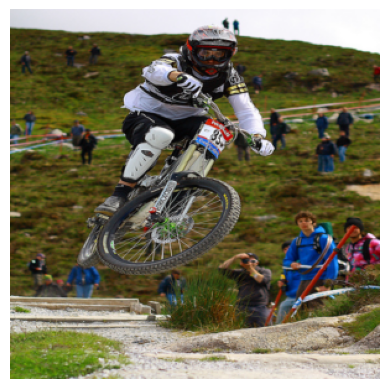

a man on a bike is riding a dirt bike .
torch.Size([1, 3, 299, 299])


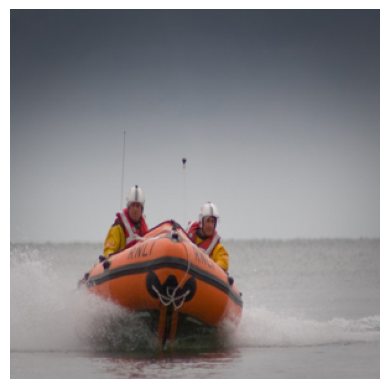

a man in a blue wetsuit is surfing .
torch.Size([1, 3, 299, 299])


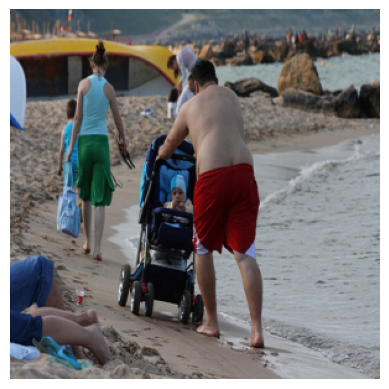

man a woman in a bikini top is standing on a beach .
torch.Size([1, 3, 299, 299])


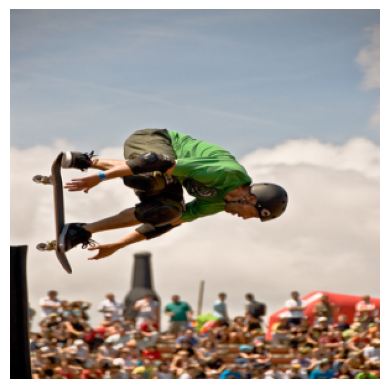

boy boy in blue shirt and blue shorts jumping off a swing .
torch.Size([1, 3, 299, 299])


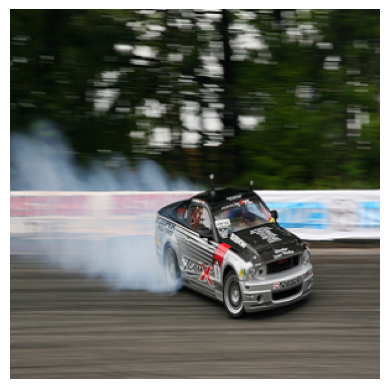

a white race car is driving through a race .
torch.Size([1, 3, 299, 299])


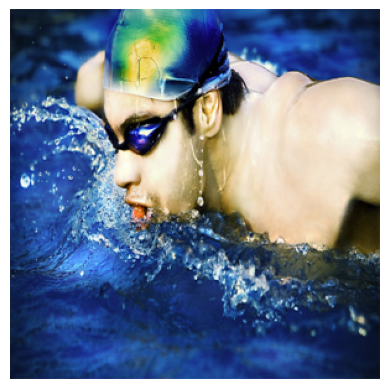

goggled a young boy wearing a blue shirt is jumping into a pool .
torch.Size([1, 3, 299, 299])


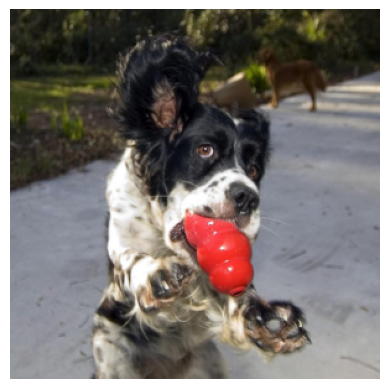

dog a black and white dog is running through the grass .
torch.Size([1, 3, 299, 299])


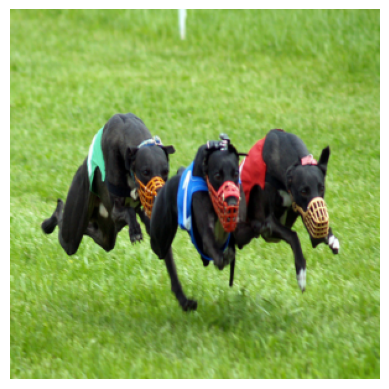

two black dogs are running through a field .
torch.Size([1, 3, 299, 299])


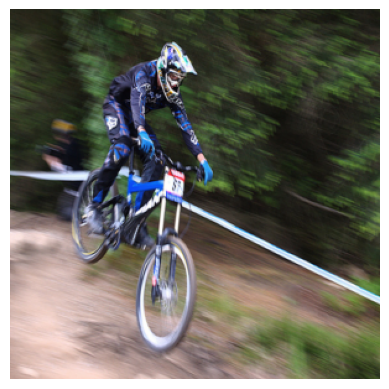

a man on a bike is riding a dirt bike .
torch.Size([1, 3, 299, 299])


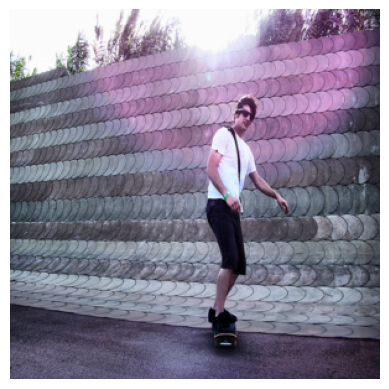

two young boys playing in a field .
torch.Size([1, 3, 299, 299])


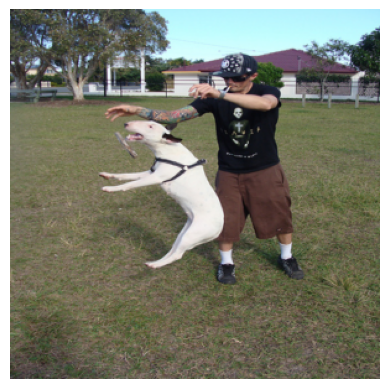

a black and white dog is running through a field .
torch.Size([1, 3, 299, 299])


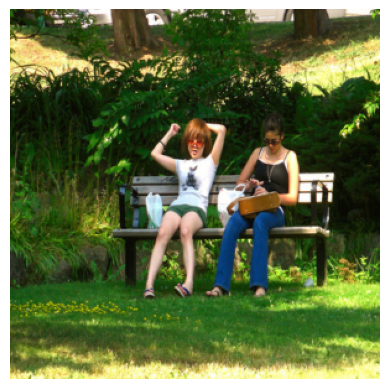

two young boys are playing in a park .
torch.Size([1, 3, 299, 299])


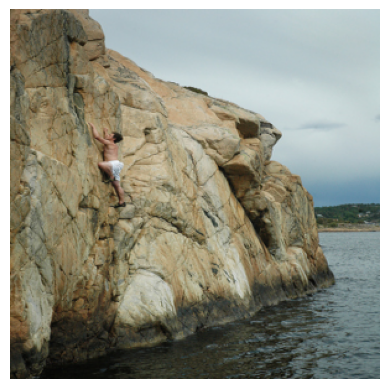

a man is standing on a rock overlooking a lake .
torch.Size([1, 3, 299, 299])


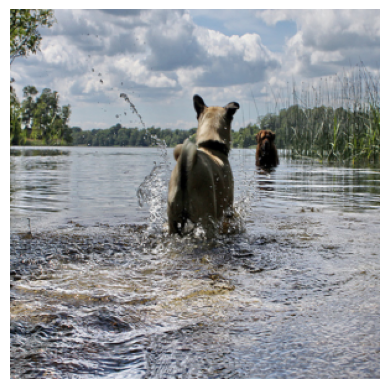

brown dog swimming in water .
torch.Size([1, 3, 299, 299])


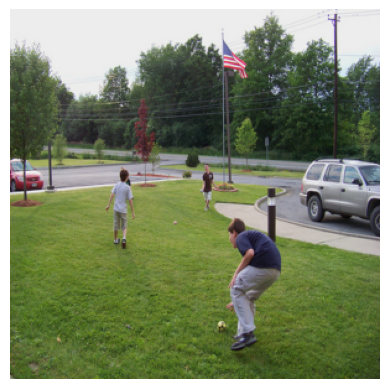

two young boys playing soccer .
torch.Size([1, 3, 299, 299])


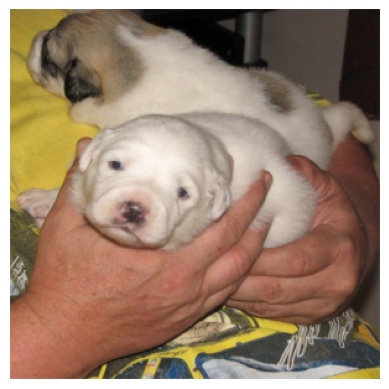

white dog with brown markings and white dog running in the grass .
torch.Size([1, 3, 299, 299])


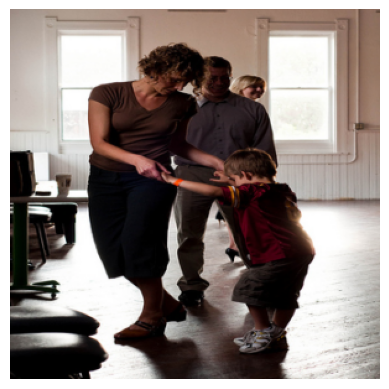

girl boy in blue shirt and blue jeans is jumping on a trampoline .
torch.Size([1, 3, 299, 299])


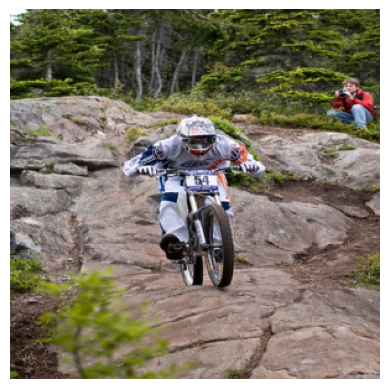

a man on a bike is jumping over a hill .
torch.Size([1, 3, 299, 299])


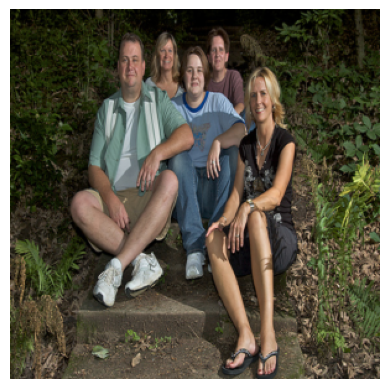

four young boys are standing on a rock wall .
torch.Size([1, 3, 299, 299])


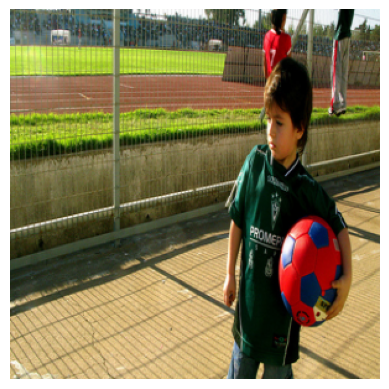

two boys playing soccer .
torch.Size([1, 3, 299, 299])


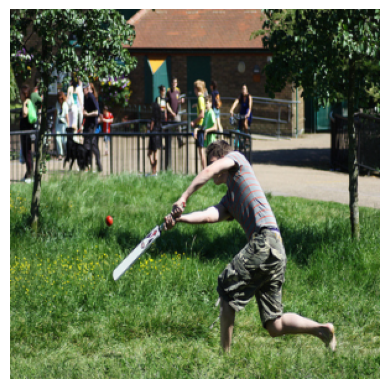

man a woman in a red shirt and a white shirt is standing on a sidewalk .
torch.Size([1, 3, 299, 299])


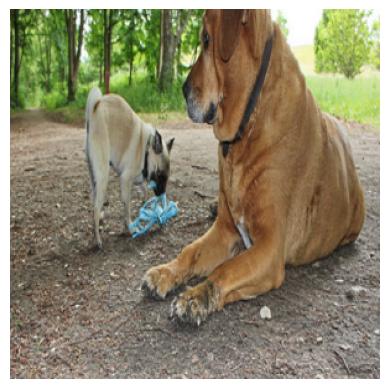

two brown dogs are playing in the snow .
torch.Size([1, 3, 299, 299])


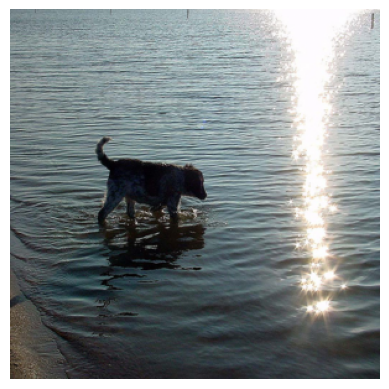

brown dog running through water .
torch.Size([1, 3, 299, 299])


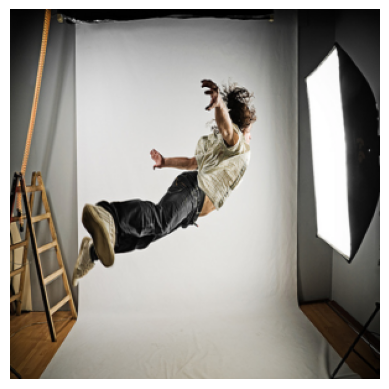

boy boy in blue shirt and blue jeans is jumping on a trampoline .
torch.Size([1, 3, 299, 299])


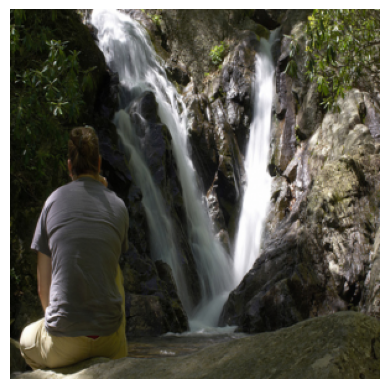

of a man in a red jacket is standing on a rock overlooking a rocky mountain .
torch.Size([1, 3, 299, 299])


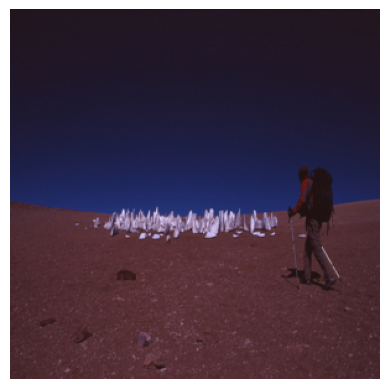

a man in a red shirt and a white shirt is standing on a rock overlooking a city .
torch.Size([1, 3, 299, 299])


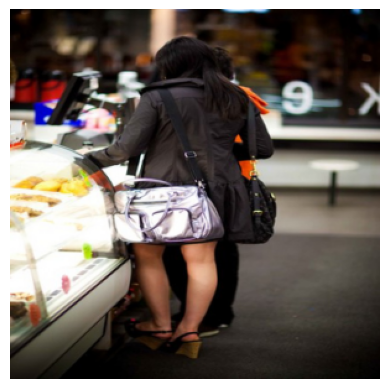

woman a woman in a white shirt and a white hat .
torch.Size([1, 3, 299, 299])


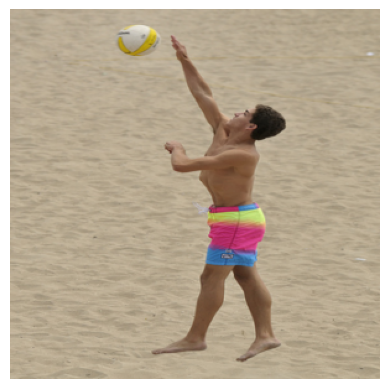

boy boy in blue shorts and blue shorts is jumping into the air .
torch.Size([1, 3, 299, 299])


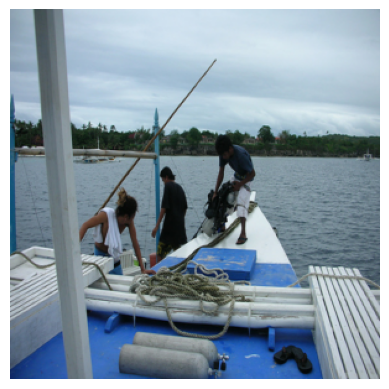

a man in a blue shirt is standing on a rock overlooking a lake .
torch.Size([1, 3, 299, 299])


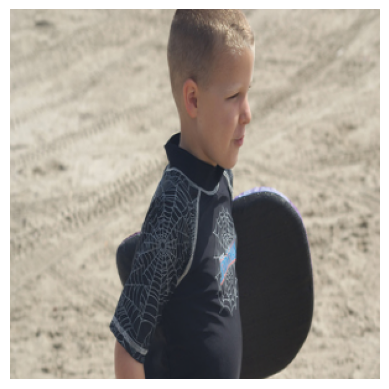

girl boy with a blue shirt and blue shirt is standing on a wooden bench .
torch.Size([1, 3, 299, 299])


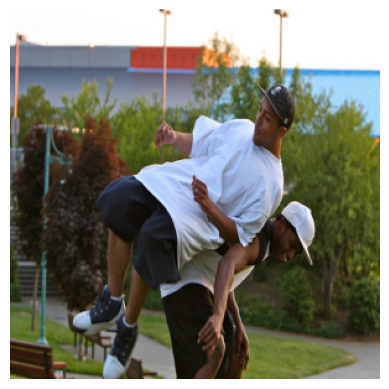

boy boy in blue shirt and blue shorts is jumping in the air .
torch.Size([1, 3, 299, 299])


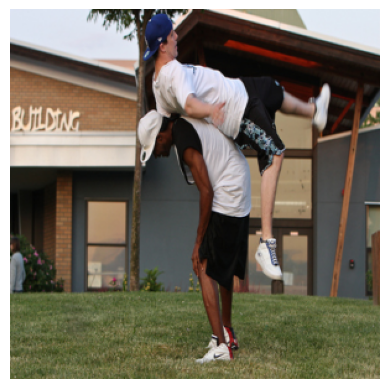

boy boy in blue shirt and blue shorts is jumping in the air .
torch.Size([1, 3, 299, 299])


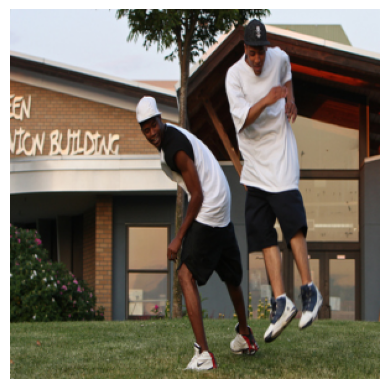

man man in a white shirt and a white shirt is standing on a sidewalk .
torch.Size([1, 3, 299, 299])


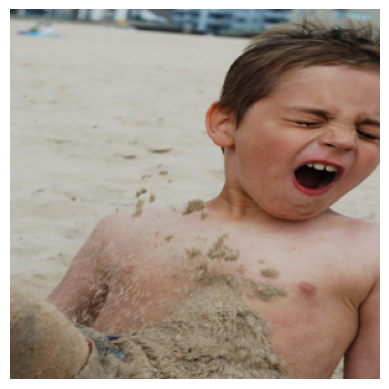

girl smiling in a swimming pool .
torch.Size([1, 3, 299, 299])


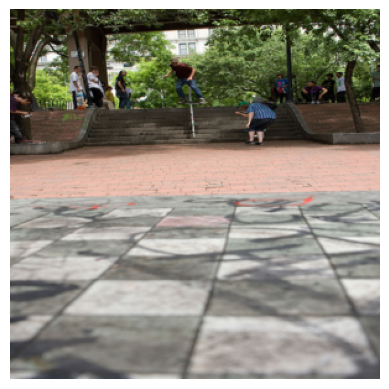

a man in a blue shirt is standing on a bench with a man in a blue shirt .
torch.Size([1, 3, 299, 299])


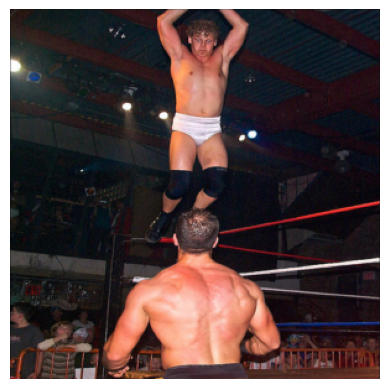

girl boy wearing a red shirt and blue shorts is jumping .
torch.Size([1, 3, 299, 299])


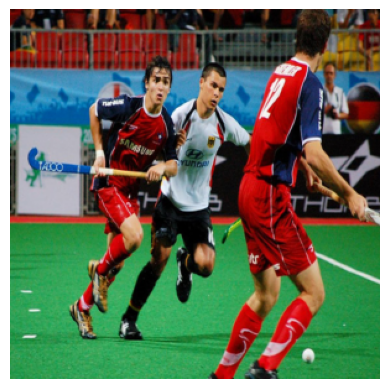

two men are playing soccer .
torch.Size([1, 3, 299, 299])


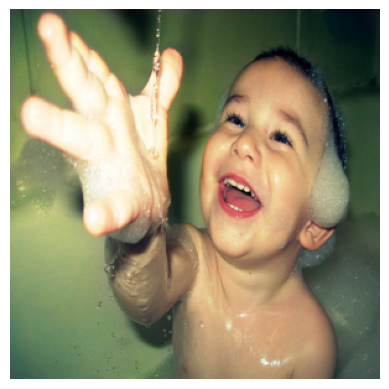

blue-eyed a toddler in a blue shirt is standing in a pool .
torch.Size([1, 3, 299, 299])


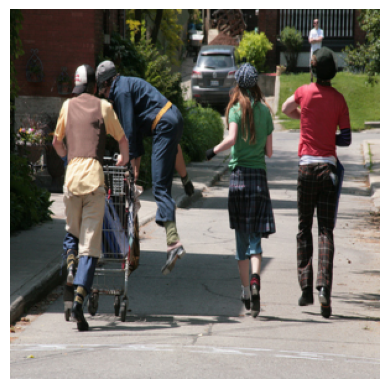

people a man in a red shirt and a woman in a white shirt and a white shirt and a black hat and a black hat .
torch.Size([1, 3, 299, 299])


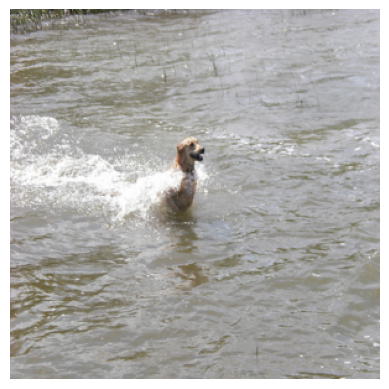

a brown dog is running through the water .
torch.Size([1, 3, 299, 299])


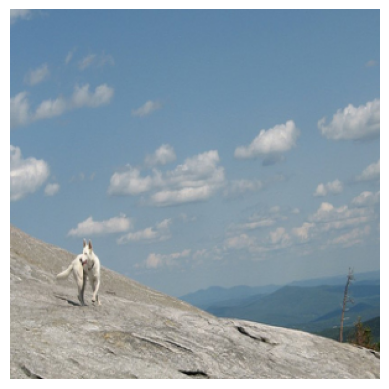

a man and a dog are standing in the snow .
torch.Size([1, 3, 299, 299])


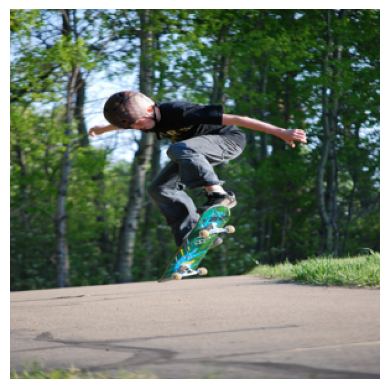

boy boy in blue shirt and blue shorts jumping off a trampoline .
torch.Size([1, 3, 299, 299])


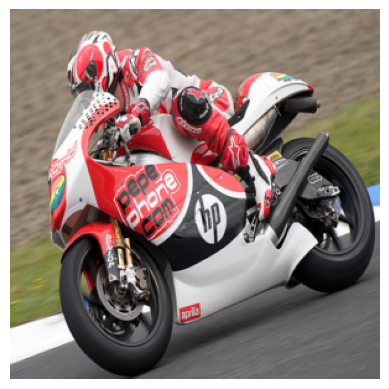

a man in a red jacket is riding a bike .
torch.Size([1, 3, 299, 299])


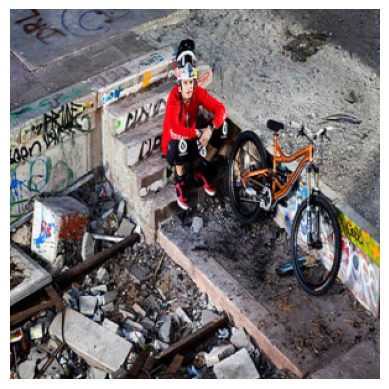

a man in a red shirt and helmet is riding a bike .
torch.Size([1, 3, 299, 299])


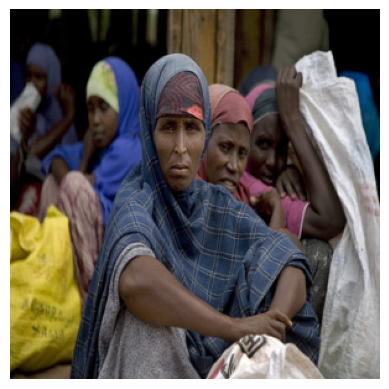

girl a woman in a red shirt and a white shirt .
torch.Size([1, 3, 299, 299])


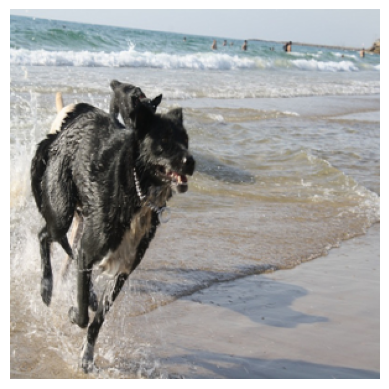

two black dogs are running through a field .
torch.Size([1, 3, 299, 299])


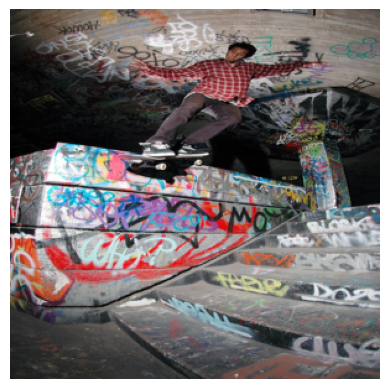

a man in a red shirt and helmet is riding a bike .
torch.Size([1, 3, 299, 299])


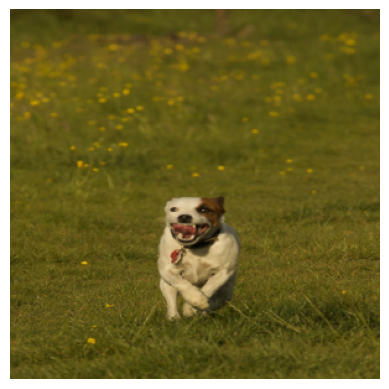

dog a brown and white dog is running through the grass .
torch.Size([1, 3, 299, 299])


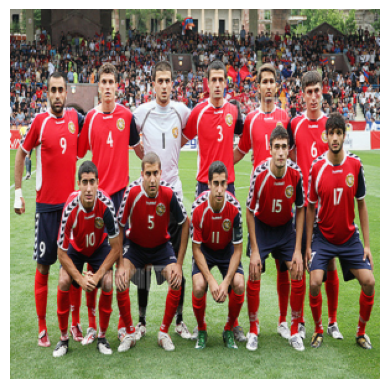

two men playing basketball .
torch.Size([1, 3, 299, 299])


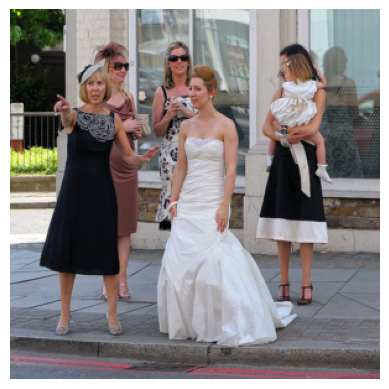

women a woman in a red dress and a white dress .
torch.Size([1, 3, 299, 299])


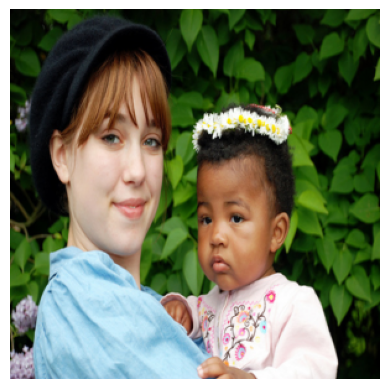

two young girls are playing with a red toy .
torch.Size([1, 3, 299, 299])


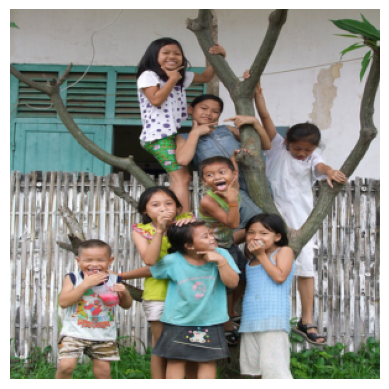

people a woman in a red shirt and a white shirt and a white shirt and a white shirt and a white shirt and a white shirt and a white shirt and a white shirt and a white shirt and a black hat .
torch.Size([1, 3, 299, 299])


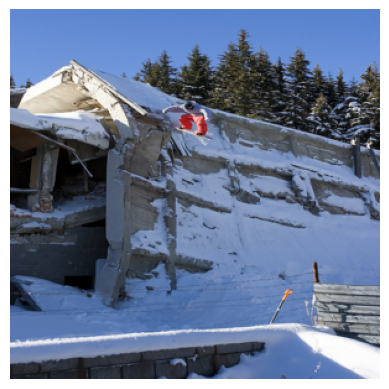

a man is riding a bike through a forest .
torch.Size([1, 3, 299, 299])


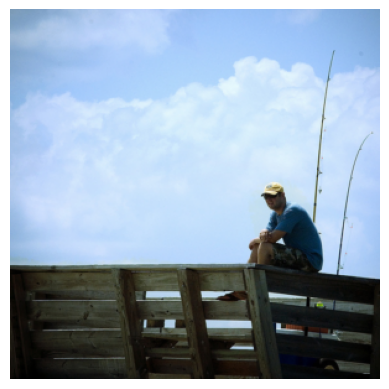

a man in a blue shirt is standing on a rock wall .
torch.Size([1, 3, 299, 299])


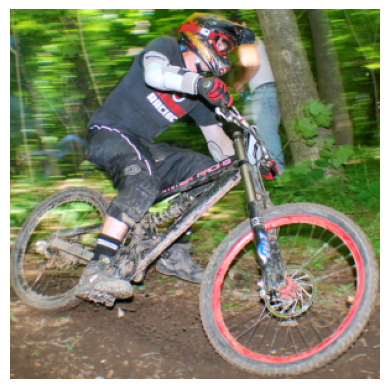

a man on a bike is riding a dirt bike .
torch.Size([1, 3, 299, 299])


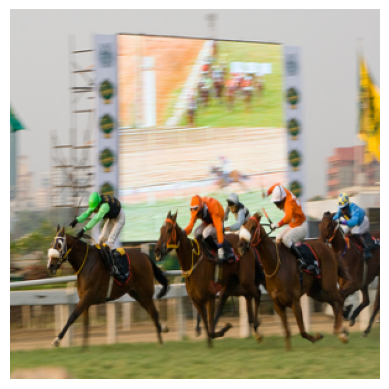

five people are standing in a field of a race .
torch.Size([1, 3, 299, 299])


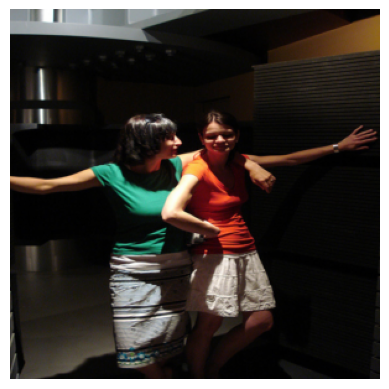

two young girls are playing with a basketball game .
torch.Size([1, 3, 299, 299])


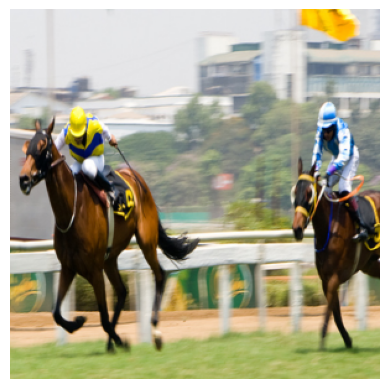

a man and a woman are standing on a bench near a large dog .
torch.Size([1, 3, 299, 299])


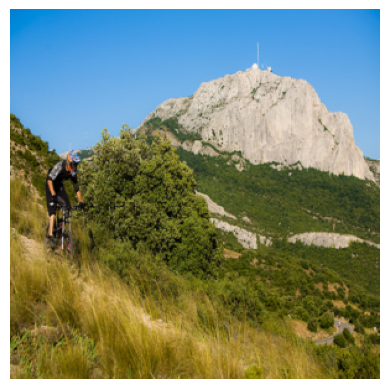

a man is standing on a mountain .
torch.Size([1, 3, 299, 299])


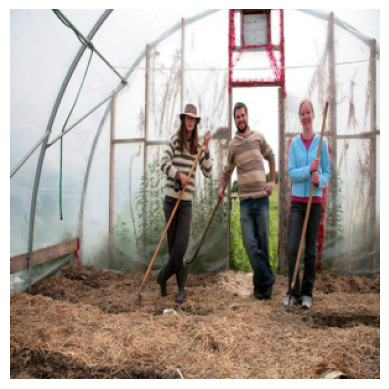

two children playing in a fountain .
torch.Size([1, 3, 299, 299])


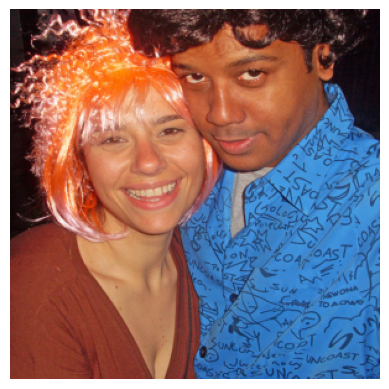

three young girls are posing for a picture .
torch.Size([1, 3, 299, 299])


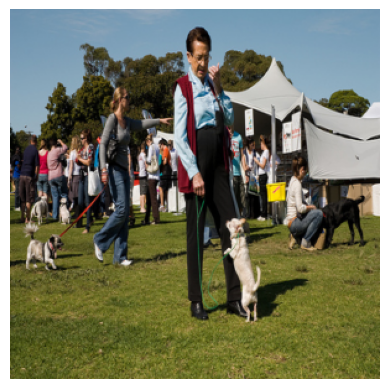

many people are standing in front of a large crowd .
torch.Size([1, 3, 299, 299])


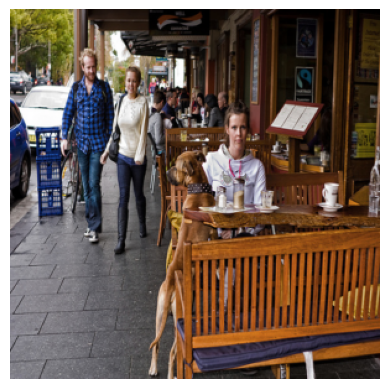

many people are standing in front of a building .
torch.Size([1, 3, 299, 299])


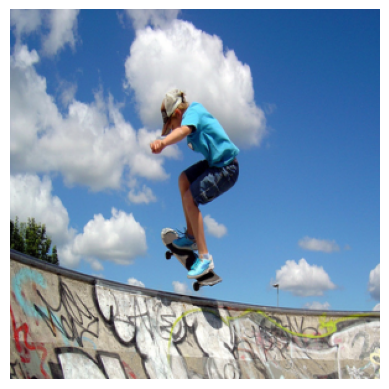

a man on a bike is jumping over a ramp .
torch.Size([1, 3, 299, 299])


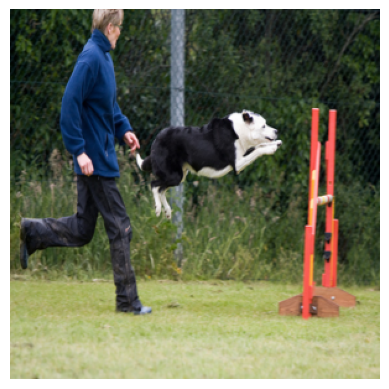

a black and white dog is running through a field .
torch.Size([1, 3, 299, 299])


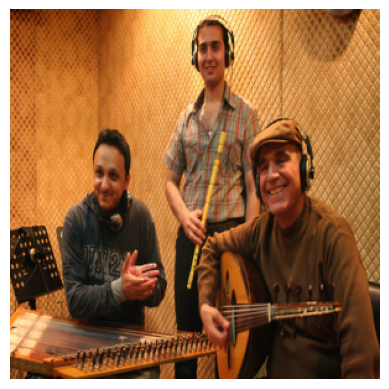

thre a man in a white shirt and a white hat is standing in front of a crowd .
torch.Size([1, 3, 299, 299])


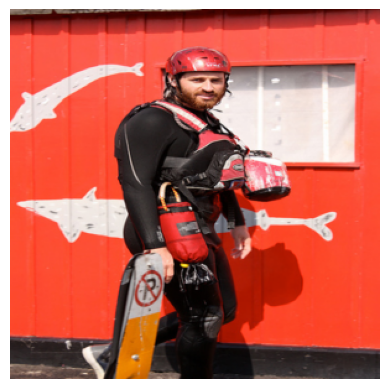

two men in red and white uniforms are riding a bike .
torch.Size([1, 3, 299, 299])


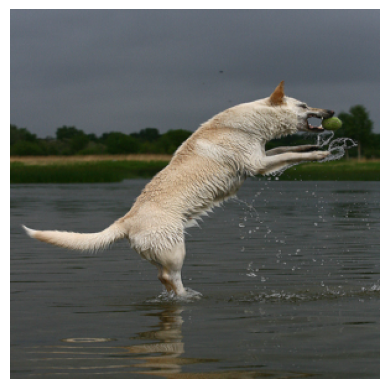

dog a brown dog is running through the water .


In [67]:
import torch
import matplotlib.pyplot as plt

model.eval()
for i in range(32364, 32800, 5):
    img = image_list[i]
    img = img.to(device)
    img = img.unsqueeze(0)
    print(img.shape)
    encode_output = model.sample(img)
    # Ensure mean and std are on the same device
    img = img.squeeze(0)
    device = img.device  
    mean = torch.tensor([0.485, 0.456, 0.406], device=device).view(3, 1, 1)
    std = torch.tensor([0.229, 0.224, 0.225], device=device).view(3, 1, 1)
    # Denormalize the image (if normalized)
    img = img * std + mean  # Undo normalization
    
    # Move to CPU before converting to NumPy
    img_numpy = img.cpu().permute(1, 2, 0).clamp(0, 1).numpy()
    # Display the image
    plt.imshow(img_numpy)
    plt.axis('off')  # Hide axis
    plt.show()
    encode_output = encode_output.squeeze(0).tolist()
    true_output = []
    for char in encode_output:
        if char == 0: 
            continue
        elif char == 1:
            break
        true_character = id2word[char]
        true_output.append(true_character)
    generated_captions = ' '.join(true_output)
    print(generated_captions)